In [ ]:
import os
import glob

# Define the root folder containing subfolders with images
root_folder = "/content/drive/MyDrive/Food Data Set 35"

# Function to count images in a folder
def count_images_in_folder(folder_path):
    image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.gif', '*.bmp']  # Add more extensions if needed
    total_images = 0

    for extension in image_extensions:
        image_files = glob.glob(os.path.join(folder_path, extension))
        total_images += len(image_files)

    return total_images

# Iterate through subfolders
cnt = 0
for dirpath, dirnames, filenames in os.walk(root_folder):
    if filenames:
        total_images = count_images_in_folder(dirpath)
        cnt += total_images
        print(f"Folder '{dirpath}' contains {total_images} images.")

print(cnt)


Folder '/content/drive/MyDrive/Food Data Set 35/Apple Pie' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Baklava' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Pav Bhaji' contains 953 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Macaroni and Cheese' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Fried Rice' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Lasagna' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Ice Cream' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Kofta' contains 811 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Paneer Tikka' contains 259 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Nachos' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Pakora' contains 1000 images.
Folder '/content/drive/MyDrive/Food Data Set 35/Macarons' contains 1000 images.
Folder '/content/drive/MyDrive/F

In [ ]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from PIL import Image
from skimage.io import imread
import cv2
import os
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

warnings.filterwarnings("ignore")
K.clear_session()

In [ ]:
K.clear_session()
path_to_model='/content/drive/MyDrive/image_to_recipie_model.h5'
print("Loading the model..")
model = load_model(path_to_model)
print("Done!")

Loading the model..
Done!


In [ ]:
category={
    0: ['Apple Pie','Apple Pie'], 1: ['Baklava','Baklava'], 2: ['Burger','Burger'],
    3: ['Burrito','Burrito'], 4: ['Chappati','Chappati'], 5: ['Cheese Plate','Dal Cheese Plate'],
    6: ['Chole Bhature','Chole Bhature'], 7: ['Creme Brulee','Creme Brulee'], 8: ['Cup Cakes','Cup Cakes'], 9: ['Dal','Dal'],
    10: ['Dhohkla','Dhokla'], 11: ['Donuts','Donuts'], 12: ['French Fries','French Fries'],
    13: ['Fried Rice','Fried Rice'], 14: ['Ice Cream','Ice Cream'], 15: ['Kofta','Kofta'],
    16: ['Lasagna','Lasagna'], 17: ['Macaroni and Cheese','Macaroni and Cheese'], 18: ['Macaroons','Macaroons'], 19: ['Nachos','Nachos'],20:['Pakora','Pakora'],21:['Panner Tikka','Panner Tikka'],
    22:['Pav Bhaji','Pav Bhaji']
    ,23:['Pizza',''],24:['Ramen',''],25:['Samosa',''],26:['Spaghetti Carbonara',''],27:['Spring Roll',''],28:['Tiramisu',''],29:['Tuna Tarrtare',''],30:['Vadapav',''],31:['Waffles','']}

def predict_image(filename,model):
    img_ = image.load_img(filename, target_size=(299, 299))
    img_array = image.img_to_array(img_)
    img_processed = np.expand_dims(img_array, axis=0)
    img_processed /= 255.

    prediction = model.predict(img_processed)

    index = np.argmax(prediction)

    plt.title("Prediction - {}".format(category[index][0]))
    plt.imshow(img_array)

1/1 [==============================] - 4s 4s/step


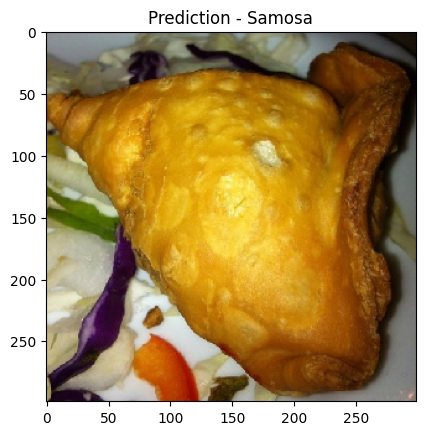

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/train/Samosa/1011601.jpg',model)

In [ ]:
from sklearn.metrics import confusion_matrix
import itertools

img_width, img_height = 299, 299

def labels_confusion_matrix():
    folder_path="/content/drive/MyDrive/Train_Test_Valid/test"

    mapping={}
    for i,j in enumerate(sorted(os.listdir(folder_path))):
        mapping[j]=i

    files=[]
    real=[]
    predicted=[]

    for i in os.listdir(folder_path):

        true=os.path.join(folder_path,i)
        true=true.split('/')[-1]
        true=mapping[true]

        for j in os.listdir(os.path.join(folder_path,i)):

            img_ = image.load_img(os.path.join(folder_path,i,j), target_size=(img_height, img_width))
            img_array = image.img_to_array(img_)
            img_processed = np.expand_dims(img_array, axis=0)
            img_processed /= 255.
            prediction = model.predict(img_processed)
            index = np.argmax(prediction)

            predicted.append(index)
            real.append(true)

    return (real,predicted)

def print_confusion_matrix(real,predicted):

    cmap="viridis"
    cm_plot_labels = [i for i in range(20)]

    cm = confusion_matrix(y_true=real, y_pred=predicted)
    df_cm = pd.DataFrame(cm,cm_plot_labels,cm_plot_labels)
    sns.set(font_scale=1.1) # for label size
    plt.figure(figsize = (15,10))
    s=sns.heatmap(df_cm, annot=True,cmap=cmap) # font size
#     bottom,top=s.get_ylim()
#     s.set_ylim(bottom+0.6,top-0.6)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig('confusion_matrix.png')
    plt.show()

In [ ]:
def get_activations(img, model_activations):
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img /= 255.
    plt.imshow(img[0])
    plt.show()
    return model_activations.predict(img)

def show_activations(activations, layer_names):

    images_per_row = 16

    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,:, :,col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()

def activation_conv():
    first_convlayer_activation = activations[0]
    second_convlayer_activation = activations[3]
    third_convlayer_activation = activations[6]
    f,ax = plt.subplots(1,3, figsize=(10,10))
    ax[0].imshow(first_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[0].axis('OFF')
    ax[0].set_title('Conv2d_1')
    ax[1].imshow(second_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[1].axis('OFF')
    ax[1].set_title('Conv2d_2')
    ax[2].imshow(third_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[2].axis('OFF')
    ax[2].set_title('Conv2d_3')


def get_attribution(food):

    tf.compat.v1.disable_eager_execution()

    img = image.load_img(food, target_size=(299, 299))
    img = image.img_to_array(img)
    img /= 255.
    f,ax = plt.subplots(1,3, figsize=(15,15))
    ax[0].imshow(img)

    img = np.expand_dims(img, axis=0)
    model = load_model('/content/drive/MyDrive/image_to_recipie_model.h5')

    preds = model.predict(img)
    class_id = np.argmax(preds[0])
    ax[0].set_title("Input Image")
    class_output = model.output[:, class_id]
    last_conv_layer = model.get_layer("mixed10")

    grads = K.gradients(class_output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([img])
    for i in range(2048):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    ax[1].imshow(heatmap)
    ax[1].set_title("Heat map")


    act_img = cv2.imread(food)
    heatmap = cv2.resize(heatmap, (act_img.shape[1], act_img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = cv2.addWeighted(act_img, 0.6, heatmap, 0.4, 0)
    cv2.imwrite('classactivation.png', superimposed)
    img_act = image.load_img('classactivation.png', target_size=(299, 299))
    ax[2].imshow(img_act)
    ax[2].set_title("Class Activation")
    plt.show()
    return preds

In [ ]:
print("Total layers in the model : ",len(model.layers),"\n")

# We start with index 1 instead of 0, as input layer is at index 0
layers = [layer.output for layer in model.layers[1:11]]
# We now initialize a model which takes an input and outputs the above chosen layers
activations_output = models.Model(inputs=model.input, outputs=layers)
# print(layers)

layer_names = []
for layer in model.layers[1:11]:
    layer_names.append(layer.name)

print("First 10 layers which we can visualize are -> ", layer_names)

Total layers in the model :  315 

First 10 layers which we can visualize are ->  ['conv2d_94', 'batch_normalization_94', 'activation_94', 'conv2d_95', 'batch_normalization_95', 'activation_95', 'conv2d_96', 'batch_normalization_96', 'activation_96', 'max_pooling2d_4']


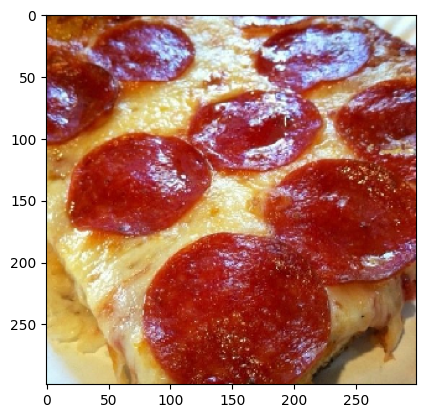

1/1 [==============================] - 0s 148ms/step


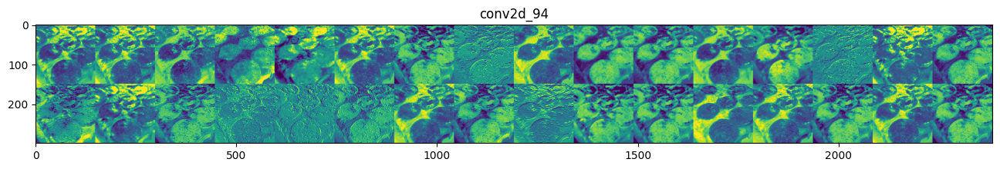

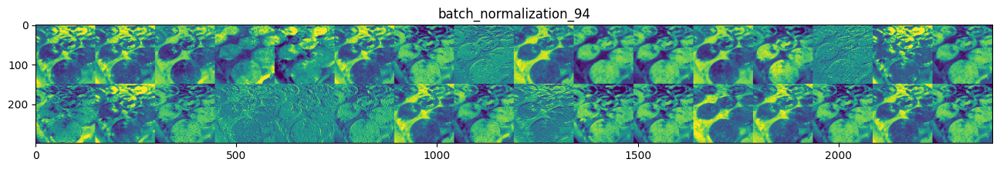

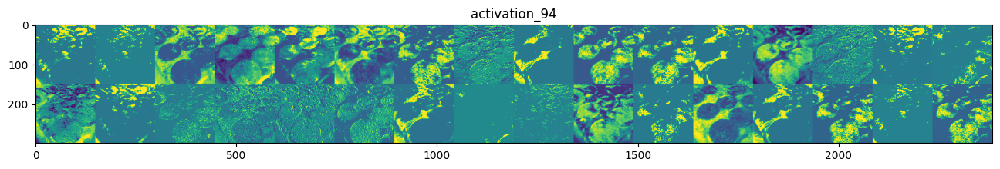

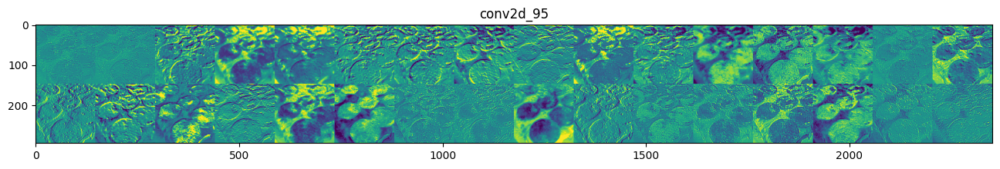

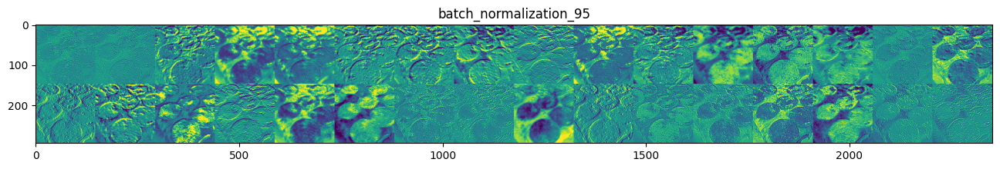

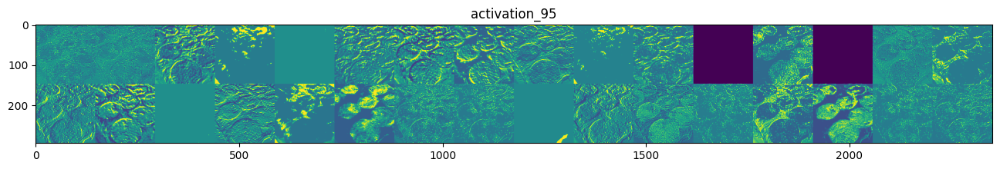

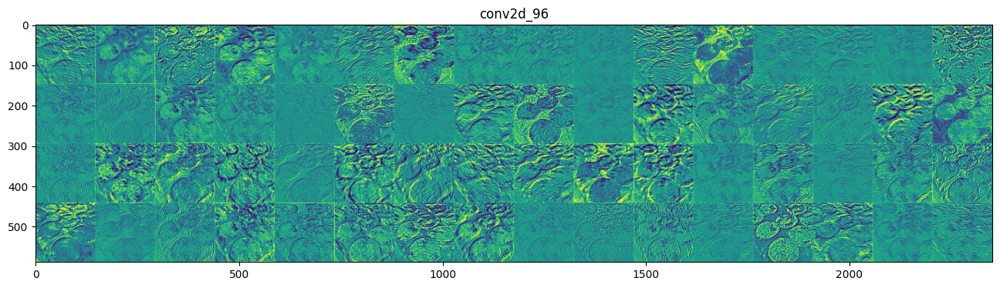

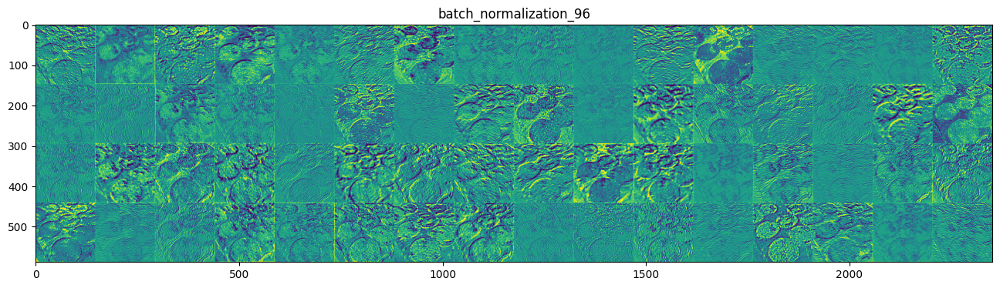

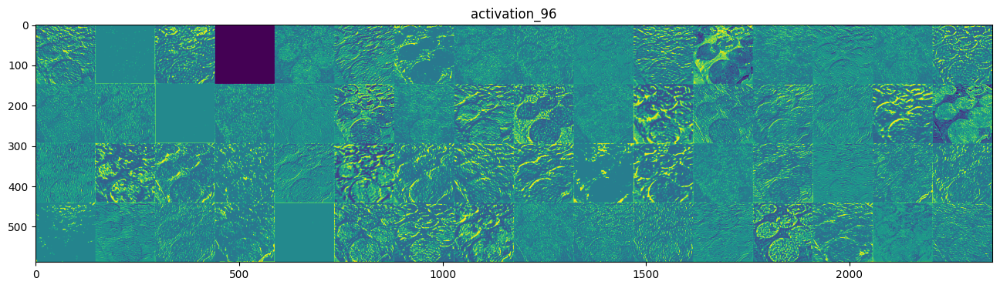

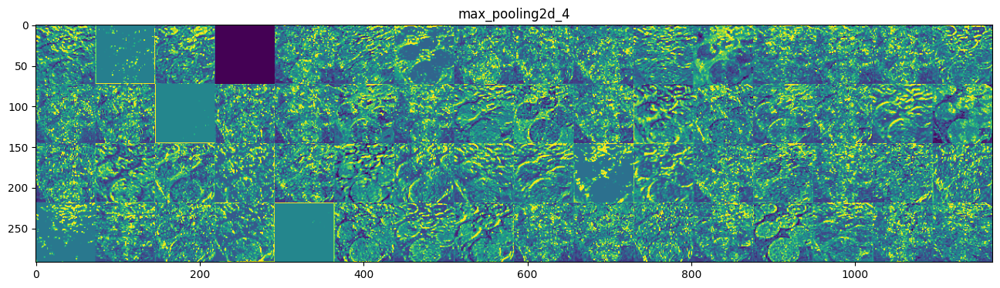

In [ ]:
food = '/content/drive/MyDrive/Train_Test_Valid/train/Pizza/1029698.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

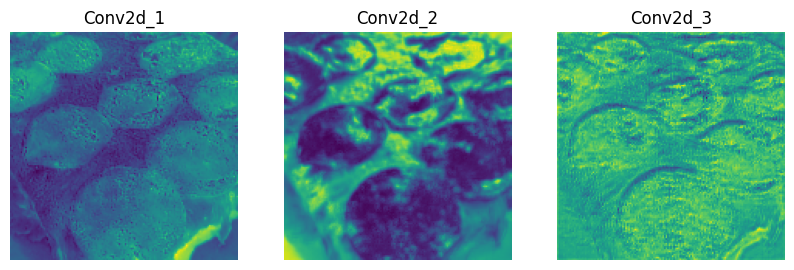

In [ ]:
activation_conv()

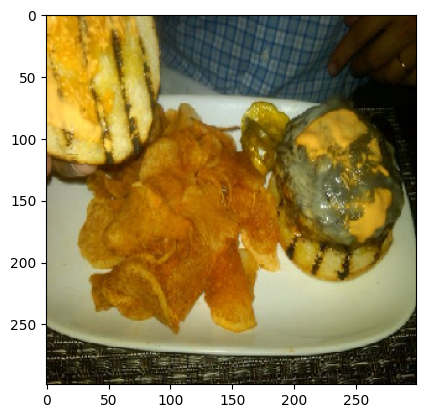

1/1 [==============================] - 0s 74ms/step


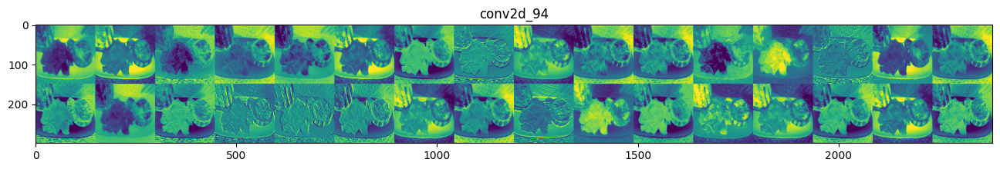

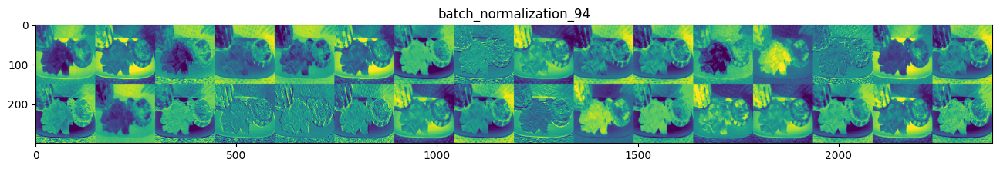

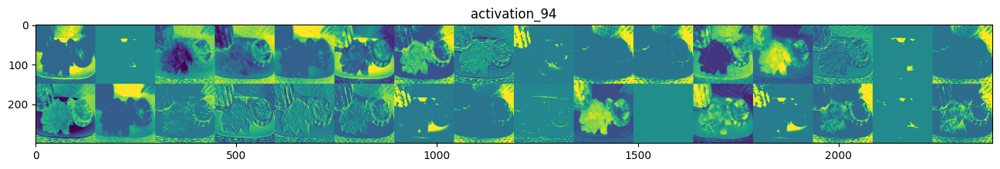

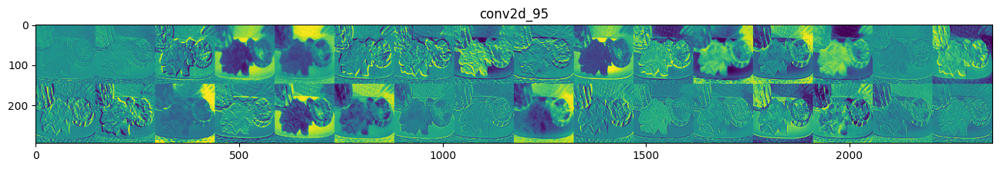

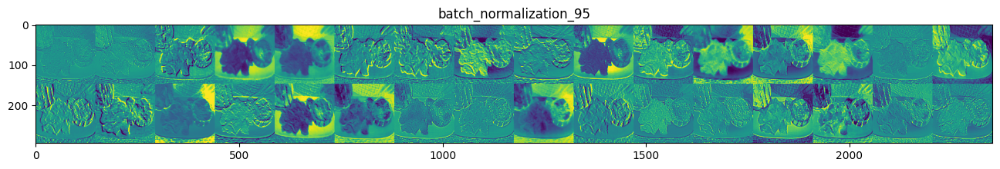

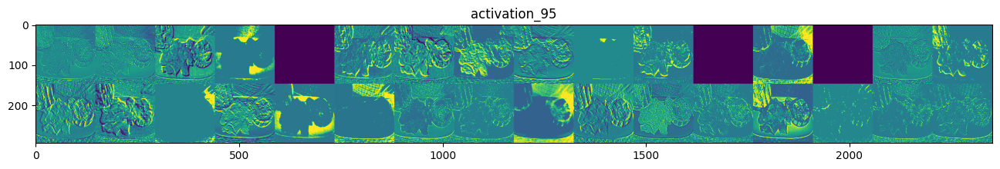

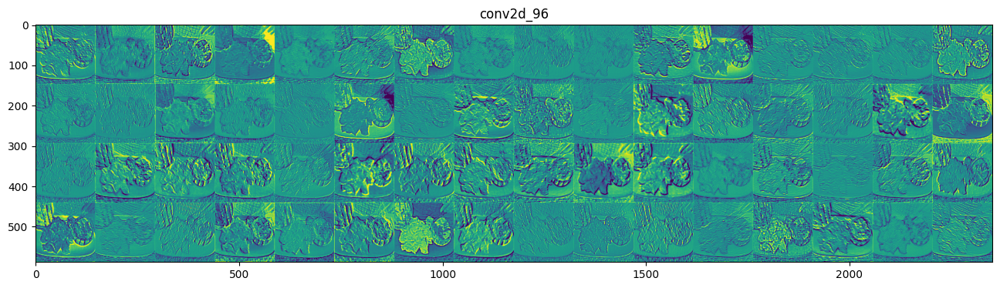

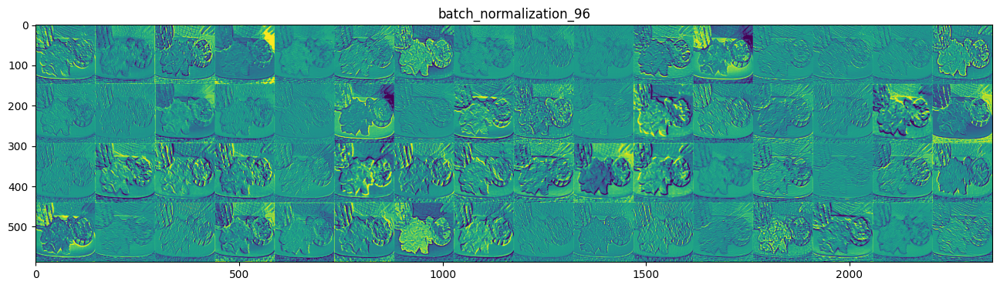

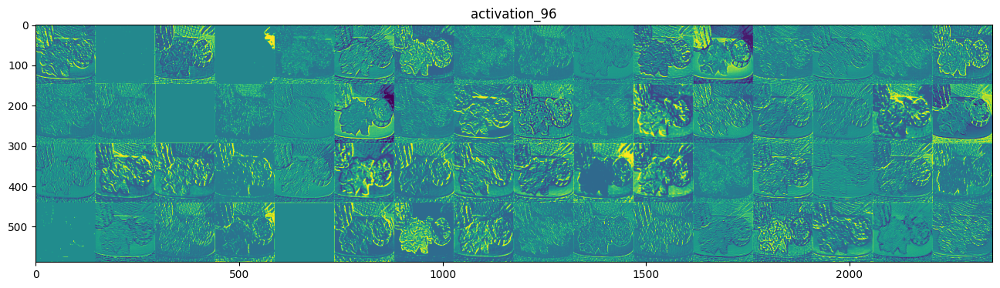

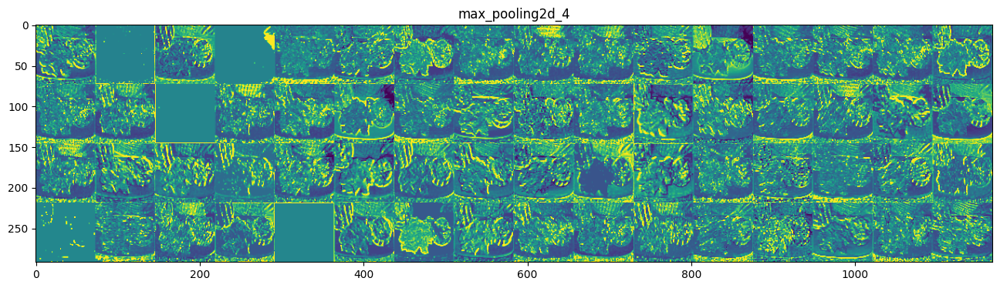

In [ ]:
food = '/content/drive/MyDrive/Train_Test_Valid/test/Burger/112314.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

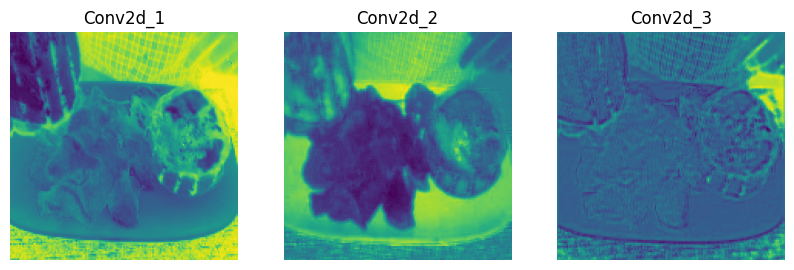

In [ ]:
activation_conv()

1/1 [==============================] - 0s 384ms/step


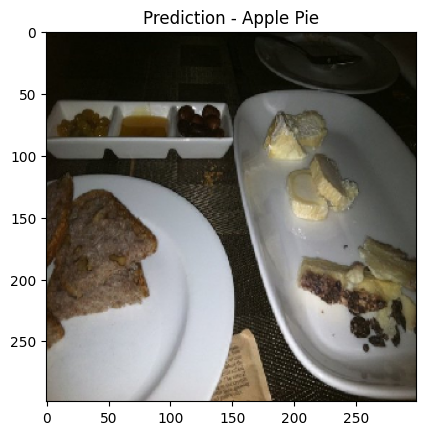

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Cheese Plate/1099770.jpg',model)

Instructions for updating:
Colocations handled automatically by placer.


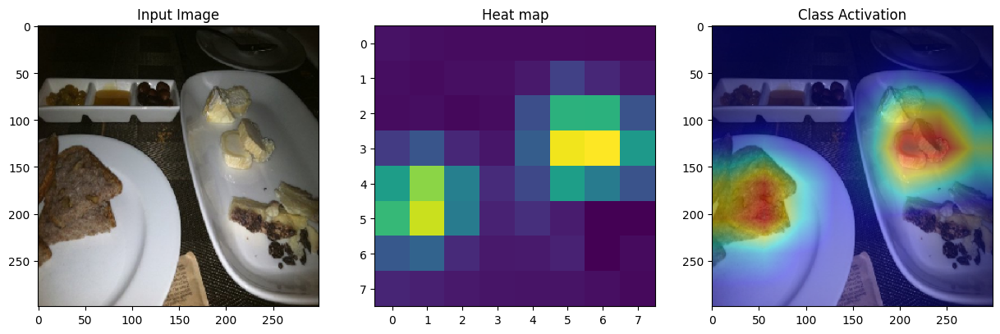

In [ ]:
pred = get_attribution('/content/drive/MyDrive/Train_Test_Valid/test/Cheese Plate/1099770.jpg')

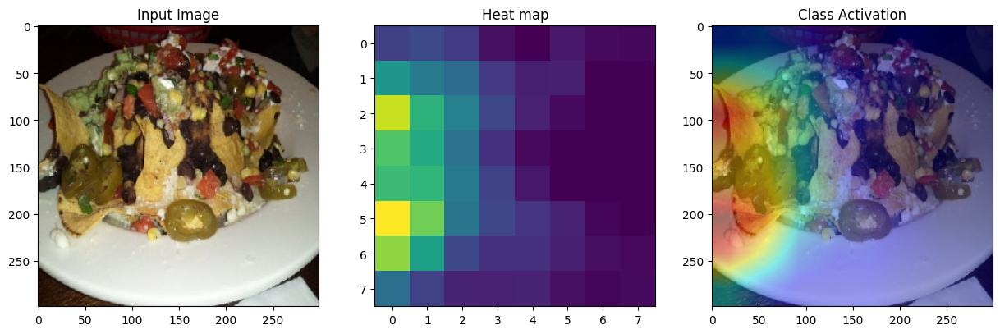

In [ ]:
pred3=get_attribution('/content/drive/MyDrive/Train_Test_Valid/test/Nachos/1093272.jpg')

In [ ]:
K.clear_session()
path_to_model='/content/drive/MyDrive/image_to_recipie_model.h5'
print("Loading the model..")
model = load_model(path_to_model)
print("Done!")

Loading the model..
Done!


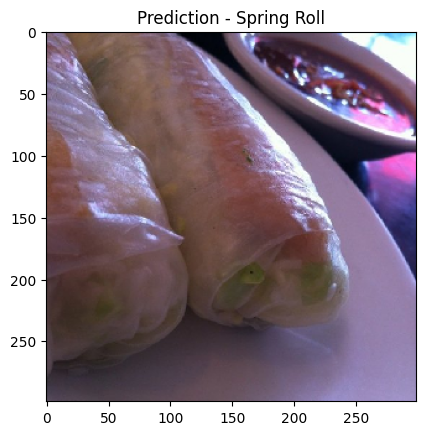

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Spring Rolls/1097540.jpg',model)

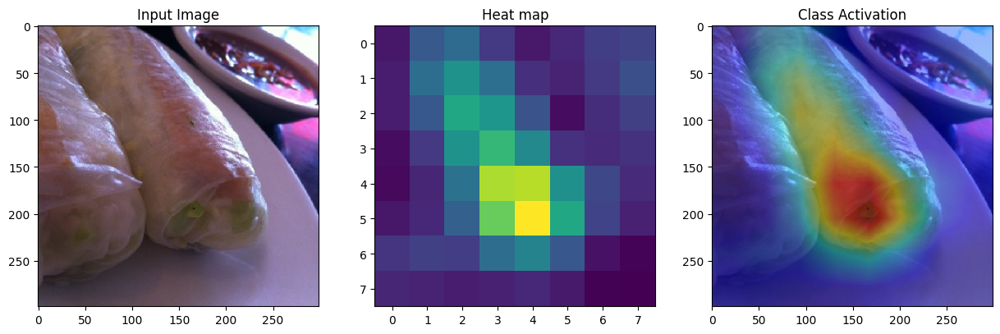

In [ ]:
pred4=get_attribution('/content/drive/MyDrive/Train_Test_Valid/test/Spring Rolls/1097540.jpg')

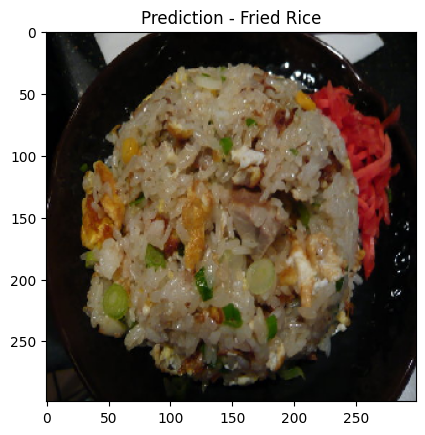

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Fried Rice/114567.jpg',model)

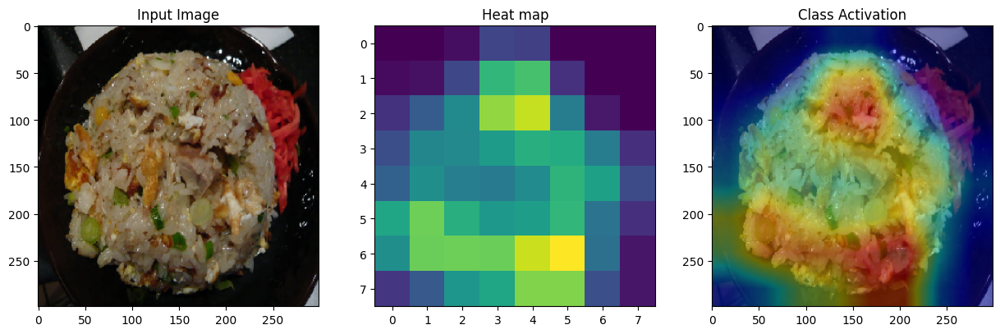

In [ ]:
pred5=get_attribution('/content/drive/MyDrive/Train_Test_Valid/test/Fried Rice/114567.jpg')

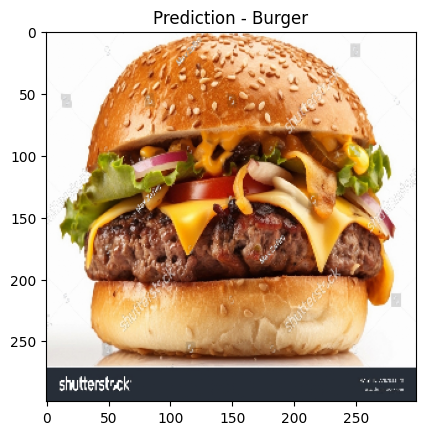

In [ ]:
predict_image('/content/burgerimg.jpg',model)

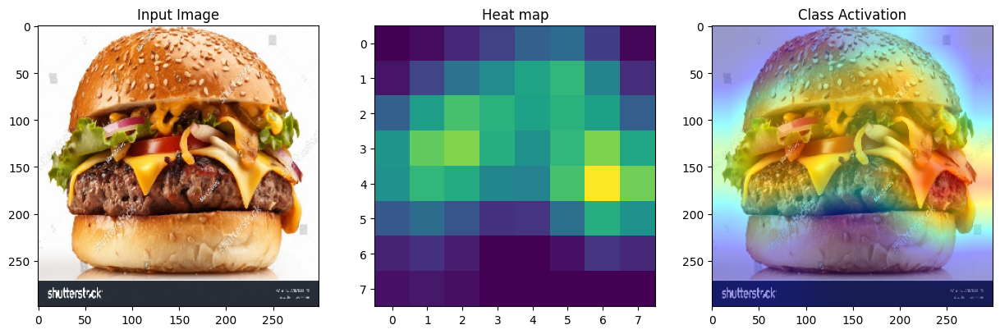

In [ ]:
pred6=get_attribution('/content/burgerimg.jpg')

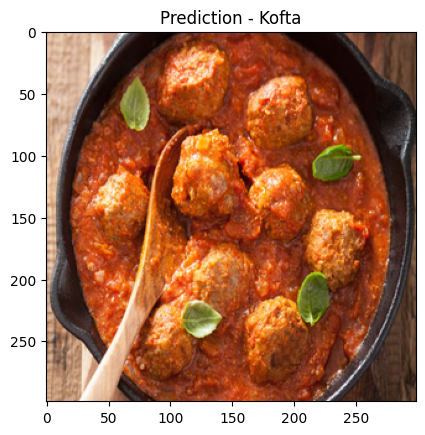

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/train/Kofta/00000003_resized.png',model)

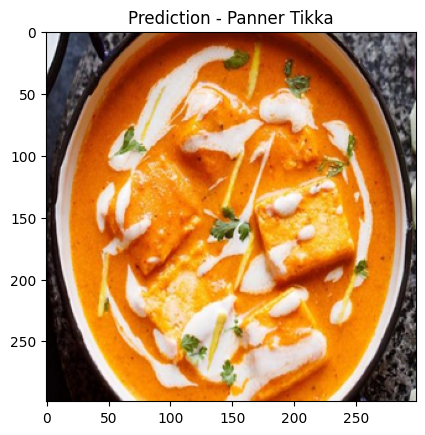

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/train/Paneer Tikka/00000004_resized.png',model)

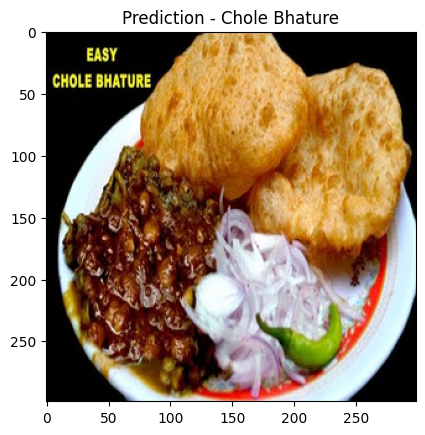

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/train/Chole Bhature/00000007_resized.png',model)

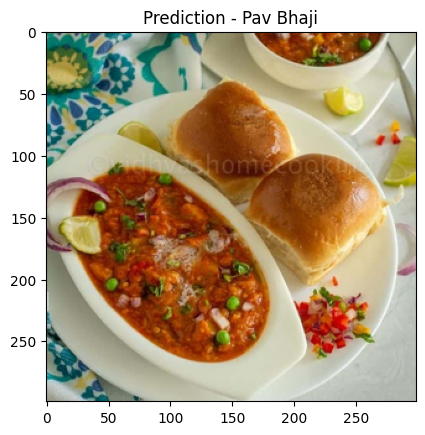

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Pav Bhaji/00000038_resized.png',model)

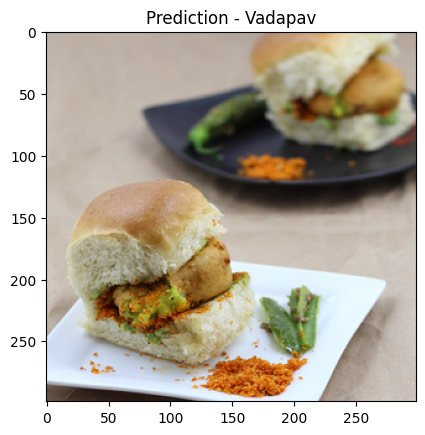

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Vadapav/00000082_resized.png',model)

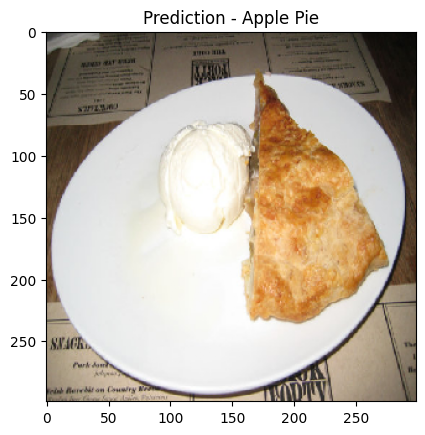

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Apple Pie/112378.jpg',model)

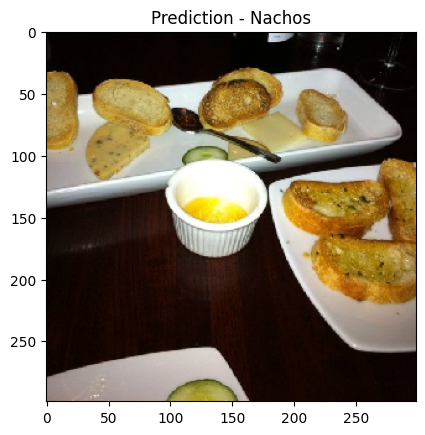

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Cheese Plate/1102817.jpg',model)

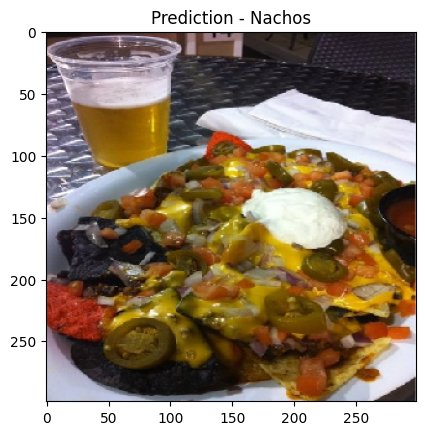

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Nachos/101954.jpg',model)

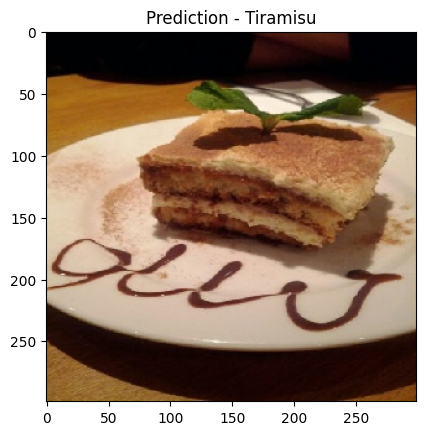

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Tiramisu/1288101.jpg',model)

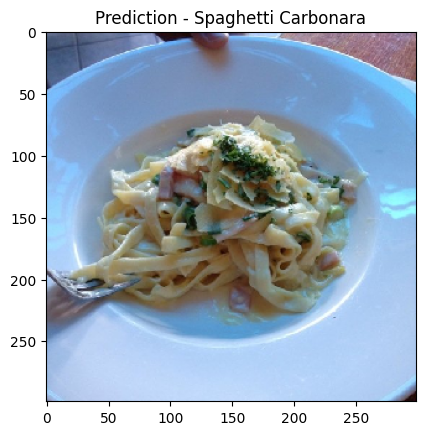

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Spaghetti Carbonara/1338578.jpg',model)

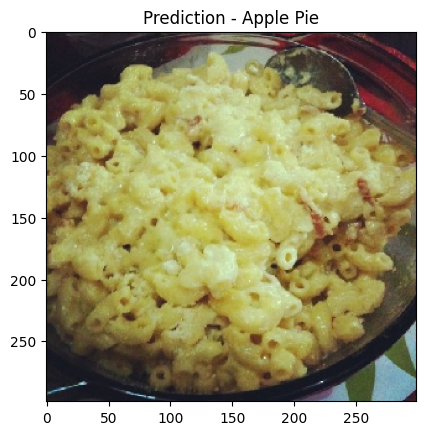

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Macaroni and Cheese/1155587.jpg',model)

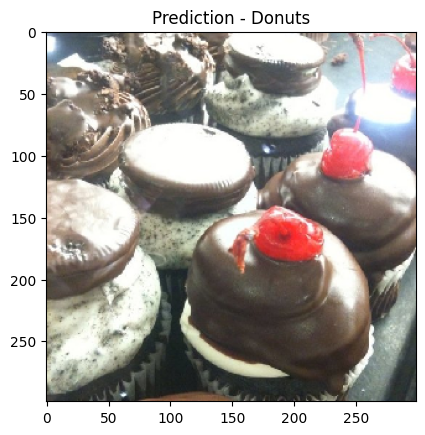

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Cup Cakes/1103694.jpg',model)

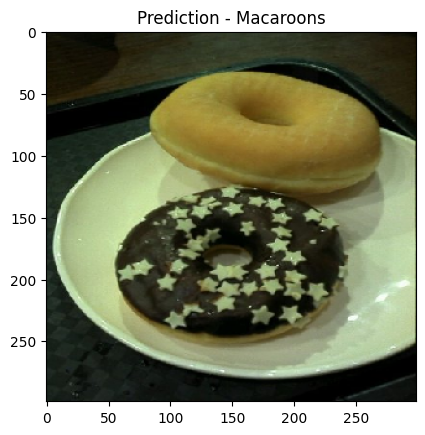

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Donuts/1078111.jpg',model)

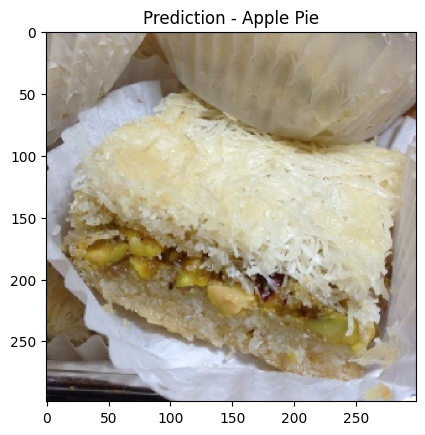

In [ ]:
predict_image('/content/drive/MyDrive/Train_Test_Valid/test/Baklava/1103986.jpg',model)

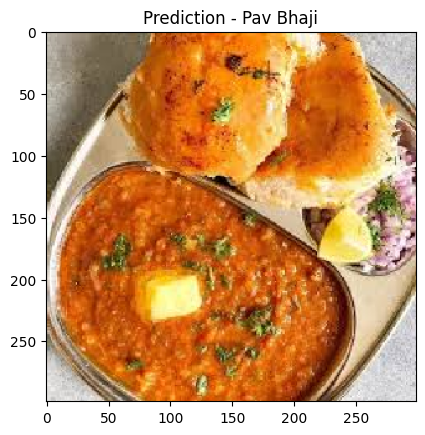

In [ ]:
predict_image('/content/images.jpeg',model)